In [3]:
import json

def load_json_data(file_path):
    with open(file_path, 'r') as file:
        data = json.load(file)
    return data

train_annotations = load_json_data('train_mini_arthropoda.json')
val_annotations = load_json_data('val_arthropoda.json')


In [6]:

def get_image_paths_and_labels(annotations):
    image_paths = []
    labels = []
    for image_info in annotations['images']:
        image_path = f"{image_info['file_name']}"  # 根据实际存储路径调整
        image_paths.append(image_path)
        # 找到该图像的所有标注
        image_annotations = [ann for ann in annotations['annotations'] if ann['image_id'] == image_info['id']]
        # 假设每个图像只有一个类别标签
        if image_annotations:
            labels.append(image_annotations[0]['category_id'])
        print(image_path)
    return image_paths, labels



In [7]:
train_image_paths, train_labels = get_image_paths_and_labels(train_annotations)
val_image_paths, val_labels = get_image_paths_and_labels(val_annotations)

train_mini/00980_Animalia_Arthropoda_Insecta_Lepidoptera_Erebidae_Arctia_virginalis/464f3a34-4c04-4eb3-afa2-6cb7444c3fa3.jpg
train_mini/02237_Animalia_Arthropoda_Insecta_Lepidoptera_Tortricidae_Cenopis_reticulatana/a0d8b298-8cf2-4e41-8a5b-352d907037f8.jpg
train_mini/01746_Animalia_Arthropoda_Insecta_Lepidoptera_Notodontidae_Ochrogaster_lunifer/e53bddc7-ef25-407a-88a8-835f7b822f1b.jpg
train_mini/00162_Animalia_Arthropoda_Diplopoda_Julida_Julidae_Ommatoiulus_moreleti/129cff22-ef59-43c9-9eda-643caa139a3b.jpg
train_mini/01904_Animalia_Arthropoda_Insecta_Lepidoptera_Nymphalidae_Lethe_portlandia/1b16e390-f0ac-437a-ae8b-d0ec48ccbecf.jpg
train_mini/02726_Animalia_Arthropoda_Malacostraca_Decapoda_Ocypodidae_Ocypode_ceratophthalmus/1ec17c0e-ba00-4569-8d58-5bebd7c49678.jpg
train_mini/02572_Animalia_Arthropoda_Insecta_Odonata_Libellulidae_Sympetrum_sanguineum/c797355e-a2b5-4c67-b158-4bcf4d0e9871.jpg
train_mini/01509_Animalia_Arthropoda_Insecta_Lepidoptera_Lycaenidae_Lycaena_xanthoides/124a49f7-37d

In [2]:
import pandas as pd


# 创建一个 DataFrame
train_data = pd.DataFrame({
    'filename': train_image_paths,
    'label': train_labels
})

val_data = pd.DataFrame({
    'filename': val_image_paths,
    'label': val_labels
})

train_data.to_csv('train_data.csv', index=False)
val_data.to_csv('val_data.csv', index=False)

KeyboardInterrupt: 

In [1]:
from keras.preprocessing.image import ImageDataGenerator
import pandas as pd
import numpy as np

train_data = pd.read_csv('train_data.csv')
val_data = pd.read_csv('val_data.csv')

train_data['label'] = train_data['label'].astype(str)
val_data['label'] = val_data['label'].astype(str)

unique_labels = np.unique(train_data['label'])
print('唯一标签总数', len(unique_labels))

train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=40,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)
# data generator
train_generator = train_datagen.flow_from_dataframe(
    dataframe=train_data,
    directory='d:/BrainBoner/inatDetection/',  # 图像文件的根目录，如果filename已经是绝对路径，则此参数可以省略
    x_col='filename',  # DataFrame中包含文件名的列名
    y_col='label',  # DataFrame中包含标签的列名
    target_size=(224, 224),  # 将图像大小调整为224x224
    batch_size=16,
    class_mode='categorical'  # 类别模式
)

val_datagen = ImageDataGenerator(rescale=1./255)

val_generator = val_datagen.flow_from_dataframe(
    dataframe=val_data,
    directory='d:/BrainBoner/inatDetection/',  # 同上
    x_col='filename',
    y_col='label',
    target_size=(224, 224),
    batch_size=16,
    class_mode='categorical'
)


唯一标签总数 2752
Found 137600 validated image filenames belonging to 2752 classes.
Found 27520 validated image filenames belonging to 2752 classes.


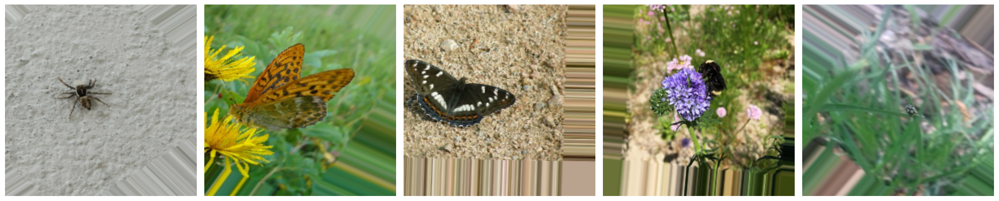

In [2]:
import matplotlib.pyplot as plt

# 获取一批图像数据
sample_training_images, _ = next(train_generator)

# 定义函数来显示图像
def plotImages(images_arr):
    fig, axes = plt.subplots(1, 5, figsize=(20,20))
    axes = axes.flatten()
    for img, ax in zip(images_arr, axes):
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()

# 显示图像
plotImages(sample_training_images[:5])


# ResNet50

In [3]:
from keras.applications import ResNet50
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D

base_model = ResNet50(weights='imagenet', include_top=False)

for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
predictions = Dense(2752, activation='softmax')(x)

model = Model(inputs=base_model.input, outputs=predictions)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()




Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, None, None,   0           ['input_1[0][0]']                
                                3)                                                                
                                                                                                  
 conv1_conv (Conv2D)            (None, None, None,   9472        ['conv1_pad[0][0]']              
                                64)                                                           

# ConvNeXt-Tiny



In [3]:
from keras.applications import convnext
from keras.models import Model
from keras.layers import Dense, GlobalAveragePooling2D

base_model = convnext.ConvNeXtTiny(include_top=False, weights='imagenet', input_shape=(224, 224, 3))

for layer in base_model.layers:
    layer.trainable = False

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
predictions = Dense(2752, activation='softmax')(x)  # num_classes 是你的类别数量

model = Model(inputs=base_model.input, outputs=predictions)

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()



Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 convnext_tiny_prestem_normaliz  (None, 224, 224, 3)  0          ['input_1[0][0]']                
 ation (Normalization)                                                                            
                                                                                                  
 convnext_tiny_stem (Sequential  (None, 56, 56, 96)  4896        ['convnext_tiny_prestem_normaliza
 )                                                               tion[0][0]']                 

# EfficientNet

In [6]:
from keras.applications import EfficientNetB0
from keras.layers import Dense, GlobalAveragePooling2D, Dropout
from keras.optimizers import SGD
from keras.models import Model
from keras.regularizers import l2

base_model = EfficientNetB0(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dropout(0.5)(x)
x = Dense(1024, activation='relu')(x)
predictions = Dense(2752, activation='softmax', kernel_regularizer=l2(0.01))(x)
model = Model(inputs=base_model.input, outputs=predictions)

model.compile(optimizer=SGD(learning_rate=0.01, momentum=0.9, nesterov=True), loss='categorical_crossentropy', metrics=['accuracy'])

model.summary()




Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_2 (Rescaling)        (None, 224, 224, 3)  0           ['input_2[0][0]']                
                                                                                                  
 normalization_1 (Normalization  (None, 224, 224, 3)  7          ['rescaling_2[0][0]']            
 )                                                                                                
                                                                                            

In [7]:
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau

checkpoint = ModelCheckpoint(filepath='ckpt.h5', monitor='val_loss', save_best_only=True, save_weights_only=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.00001, verbose=1)

In [8]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=10,
    validation_data=val_generator,
    validation_steps=len(val_generator),
    verbose=1,
    callbacks=[checkpoint, reduce_lr]
)

Epoch 1/10
8600/8600 [==============================] - 1198s 139ms/step - loss: 8.2487 - accuracy: 0.0071 - val_loss: 9.5658 - val_accuracy: 2.5436e-04 - lr: 0.0100
Epoch 2/10
8600/8600 [==============================] - 1172s 136ms/step - loss: 7.4505 - accuracy: 0.0277 - val_loss: 9.8008 - val_accuracy: 4.3605e-04 - lr: 0.0100
Epoch 3/10
8600/8600 [==============================] - 1170s 136ms/step - loss: 7.3010 - accuracy: 0.0451 - val_loss: 10.1035 - val_accuracy: 4.3605e-04 - lr: 0.0100
Epoch 4/10
8600/8600 [==============================] - 1173s 136ms/step - loss: 7.2058 - accuracy: 0.0581 - val_loss: 9.3010 - val_accuracy: 3.9971e-04 - lr: 0.0100
Epoch 5/10
8600/8600 [==============================] - 1100s 128ms/step - loss: 7.1462 - accuracy: 0.0686 - val_loss: 9.5546 - val_accuracy: 3.6337e-04 - lr: 0.0100
Epoch 6/10
8600/8600 [==============================] - 1058s 123ms/step - loss: 7.0838 - accuracy: 0.0804 - val_loss: 10.3982 - val_accuracy: 3.2703e-04 - lr: 0.0100
Ep

# Continue training




In [ ]:
from keras.applications import EfficientNetB0
from keras.layers import Dense, GlobalAveragePooling2D
from keras.optimizers import SGD
from keras.models import Model

base_model = EfficientNetB0(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(1024, activation='relu')(x)
predictions = Dense(2752, activation='softmax')(x)
modelContinue = Model(inputs=base_model.input, outputs=predictions)

modelContinue.compile(optimizer=SGD(learning_rate=0.01, momentum=0.9, nesterov=True), loss='categorical_crossentropy', metrics=['accuracy'])

modelContinue.summary()

In [10]:
modelContinue.load_weights('ckpt.h5')

In [11]:
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau


checkpoint = ModelCheckpoint(filepath='ckpt.h5', monitor='val_loss', save_best_only=True, save_weights_only=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.1, patience=3, min_lr=0.00001, verbose=1)

In [12]:

ContinuedHistory = modelContinue.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=10,
    validation_data=val_generator,
    validation_steps=len(val_generator),
    verbose=1,
    callbacks=[checkpoint, reduce_lr]
)



Epoch 1/10
8600/8600 [==============================] - 1053s 122ms/step - loss: 3.7567 - accuracy: 0.2295 - val_loss: 19.2261 - val_accuracy: 3.9971e-04 - lr: 0.0100
Epoch 2/10
8600/8600 [==============================] - 1067s 124ms/step - loss: 2.9358 - accuracy: 0.3420 - val_loss: 9.3909 - val_accuracy: 3.6337e-04 - lr: 0.0100
Epoch 3/10
8600/8600 [==============================] - ETA: 0s - loss: 2.5558 - accuracy: 0.4078

# ResNet fine-tuning

In [14]:
from keras.models import load_model

model = load_model('ckpt.h5')

# 逐步解冻每一层
for i in range(len(base_model.layers)-1, 0, -1):
    # 解冻当前层
    base_model.layers[i].trainable = True
    
    # 重新编译模型（这是必须的，以使新的可训练设置生效）
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

    model.load_weights('ckpt_weights.h5')


    
    # 继续训练模型
    history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=1,
    validation_data=val_generator,
    validation_steps=len(val_generator),
    verbose=1,
    callbacks=[lr_monitor, reduce_lr]
    )

    model.save(filepath='ckpt.h5')
    model.save_weights(filepath='ckpt_weights.h5')


8600/8600 [==============================] - ETA: 0s - loss: 7.9358 - accuracy: 2.6890e-04